In [1]:
# %matplotlib notebook
import os 
from pathlib import Path
import collections
import pickle
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score, f1_score, log_loss

import shared.utils as utils
from waterbirds import data_builder



In [7]:
BASE_DIR = '/data/ddmg/slabs/waterbirds'
RANDOM_SEED = 0 
PIXEL = 224
PFLIP0 = 0.01 
PFLIP1 = 0.01 
L2_PENALTY = 0.0 
PY0 = 0.5
PY1_Y0 = 0.5
DROPOUT_RATE = 0.0 
EMBEDDING_DIM = 10
ARCHITECTURE = "pretrained_resnet"
BATCH_SIZE = 64


P_TR = 0.8
PY1_Y0_SHIFT_LIST = [.1, .2, .3, .4, .5, .6, .7, .8, .9, .95]


In [8]:
MODEL_SPECS = {
    'slabs_u': {
        'sigma':10.0, 'alpha': 1, 'weighted_mmd': 'False', 
        'balanced_weights': 'False', 'clean_name': 'U-Ours'
    }, 
    'slabs_w': {
        'sigma':10.0, 'alpha': 1, 'weighted_mmd': 'True', 
        'balanced_weights': 'True', 'clean_name': 'W-Ours'
    },     
    'slabs_v': {
        'sigma':10.0, 'alpha': 1, 'weighted_mmd': 'True', 
        'balanced_weights': 'False', 'clean_name': 'W-Ours (no bal)'
    },   
    
    'slabs_x_u': {
        'sigma':10.0, 'alpha': 1e3, 'weighted_mmd': 'False', 
        'balanced_weights': 'False', 'clean_name': 'U-Ours-X'
    }, 
    'slabs_x_w': {
        'sigma':10.0, 'alpha': 1e3, 'weighted_mmd': 'True', 
        'balanced_weights': 'True', 'clean_name': 'W-Ours-X'
    },     
    'slabs_x_v': {
        'sigma':10.0, 'alpha': 1e3, 'weighted_mmd': 'True', 
        'balanced_weights': 'False', 'clean_name': 'W-Ours-X (no bal)'
    },   
    
    'simple_baseline': {
        'sigma': 10.0, 'alpha': 0.0, 
        'weighted_mmd': 'False', 'balanced_weights': 'False', 'clean_name': 'DNN'
    }, 
    'weighted_baseline': {
        'sigma': 10.0, 'alpha': 0.0, 
        'weighted_mmd': 'True', 'balanced_weights': 'False', 
        'clean_name': 'W-DNN'},    
}

In [10]:
input_fns = data_builder.build_input_fns(
			p_tr=P_TR,
			py0=PY0,
			py1_y0=PY1_Y0,
			py1_y0_s=PY1_Y0_SHIFT_LIST,
			pflip0=PFLIP0,
			pflip1=PFLIP1,
			oracle_prop=0.0,
			random_seed=RANDOM_SEED)
training_data_size, train_input_fn, valid_input_fn, Kfold_input_fn_creater, eval_input_fn_creater = input_fns


In [11]:
def get_last_saved_model(estimator_dir):
    subdirs = [x for x in Path(estimator_dir).iterdir()
           if x.is_dir() and 'temp' not in str(x)]
    latest = str(sorted(subdirs)[-1])
    return latest 


In [17]:
def get_model(model_name):
    param_dict = {
        'random_seed': RANDOM_SEED,
        'pflip0': PFLIP0,
        'pflip1': PFLIP1,
        'pixel': PIXEL,
        'py0': PY0, 
        'py1_y0': PY1_Y0, 
        'l2_penalty': L2_PENALTY,
        'dropout_rate': DROPOUT_RATE,
        'embedding_dim': EMBEDDING_DIM,
        'sigma': MODEL_SPECS[model_name]['sigma'],
        'alpha': MODEL_SPECS[model_name]['alpha'],
        "architecture": ARCHITECTURE,
        "batch_size": BATCH_SIZE,
        'weighted_mmd': MODEL_SPECS[model_name]['weighted_mmd']
    }
    
    if "balanced_weights" in MODEL_SPECS[model_name].keys():
        param_dict['balanced_weights'] = MODEL_SPECS[model_name]['balanced_weights']
        
    param_dict_ordered = collections.OrderedDict(sorted(param_dict.items()))
    keys, values = zip(*param_dict_ordered.items())
    model_config = dict(zip(keys, values))

    model_hash_string = utils.config_hasher(model_config)
    model_hash_dir = os.path.join(BASE_DIR, 'tuning', model_hash_string, 'epoch_100_saved_model')
    last_model_dir = get_last_saved_model(model_hash_dir)
    loaded = tf.saved_model.load(last_model_dir)
    model = loaded.signatures["serving_default"]
    return model 

In [14]:
def get_eval_data(eval_input_fn_creater, shift_list):
    # --this will have all the x's and y's for all shifts 
    eval_x = {}
    eval_y = {}
    
    # -- get each shift data 
    for py in shift_list: 
        eval_fn = eval_input_fn_creater(py, {'pixel': PIXEL, 'batch_size': BATCH_SIZE})
        current_eval_data = eval_fn()
        
        current_eval_x = []
        current_eval_y = []

        for batch_id, examples in enumerate(current_eval_data):
            if batch_id %50 == 0:
                print(f'-----{py}: {batch_id}/{len(current_eval_data)}----')
            x, y = examples
            y = y['labels']
            current_eval_x.append(x)
            current_eval_y.append(y)

        current_eval_x = tf.convert_to_tensor(np.concatenate(current_eval_x))
        current_eval_y = np.concatenate(current_eval_y)
        eval_x[py] = current_eval_x
        eval_y[py] = current_eval_y
    return eval_x, eval_y
        
        
    

In [15]:
eval_x, eval_y = get_eval_data(eval_input_fn_creater, PY1_Y0_SHIFT_LIST)


-----0.5: 0/3----


In [19]:
def plot_prediction_distribution_at_py(py, model_name):
    # ---load the model 
    model = get_model(model_name)

    # --- get the predictions
    x = eval_x[py]
    y = eval_y[py]
    preds = model(tf.convert_to_tensor(x))['probabilities'].numpy()

    
    mask11 = (y[:,0] ==1) * (y[:,1] ==1) 
    preds11 = preds[mask11]
    mask10 = (y[:,0] ==1) * (y[:,1] ==0) 
    preds10 = preds[mask10]

    mask01 = (y[:,0] ==0) * (y[:,1] ==1) 
    preds01 = preds[mask01]
    mask00 = (y[:,0] ==0) * (y[:,1] ==0) 
    preds00 = preds[mask00]
    
    # --- fig split by main label 
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    _ = axes[0].hist(preds11, 10, density=False, facecolor='b', alpha=0.3)
    _ = axes[0].hist(preds10, 10, density=False, facecolor='g', alpha=0.3)
    axes[0].set_xlabel("Predicted Probability of Waterbird")
    axes[0].set_title("Bird = Water")

    _ = axes[1].hist(preds01, 10, density=False, facecolor='b', alpha=0.3, label = 'Water background')
    _ = axes[1].hist(preds00, 10, density=False, facecolor='g', alpha=0.3, label = 'Land background')
    axes[1].set_xlabel("Predicted Probability of Waterbird")
    axes[1].set_title("Bird = Land")
    axes[1].legend()
    fig.suptitle(f"{MODEL_SPECS[model_name]['clean_name']} split by main label")

    plt.show()
    plt.clf()
    plt.close()
    
    # --- fig split by backrgound label 
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    _ = axes[0].hist(preds11, 10, density=False, facecolor='b', alpha=0.3)
    _ = axes[0].hist(preds01, 10, density=False, facecolor='g', alpha=0.3)
    axes[0].set_xlabel("Predicted Probability of Waterbird")
    axes[0].set_title("Background = Water")
    

    _ = axes[1].hist(preds10, 10, density=False, facecolor='b', alpha=0.3, label = 'Water bird')
    _ = axes[1].hist(preds00, 10, density=False, facecolor='g', alpha=0.3, label = 'Land bird')
    axes[1].set_xlabel("Predicted Probability of Waterbird")
    axes[1].set_title("Background = Land")
    axes[1].legend()
    fig.suptitle(f"{MODEL_SPECS[model_name]['clean_name']} split by background label")

    plt.show()
    plt.clf()
    plt.close()
    

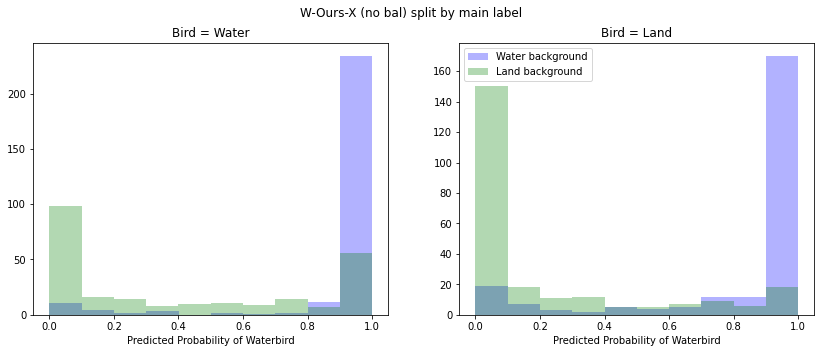

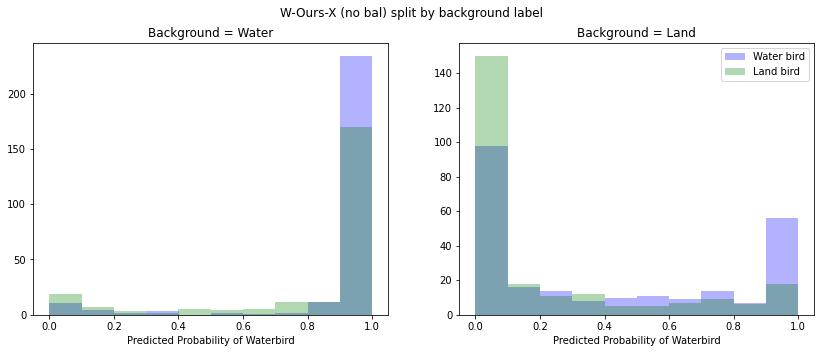

In [20]:
plot_prediction_distribution_at_py(0.5, 'slabs_x_v')

In [22]:
def get_metrics_across_py(model_name, shift_list):
    # ---load the model 
    model = get_model(model_name)

    pred11_dict = {}
    pred10_dict = {}
    pred01_dict = {}
    pred00_dict = {}

    acc11_dict = {}
    acc10_dict = {}
    acc01_dict = {}
    acc00_dict = {}
    acc_dict = {}

    loss11_dict = {}
    loss10_dict = {}
    loss01_dict = {}
    loss00_dict = {}
    loss_dict = {}

    auc_dict = {}
    f1_dict = {}

    for py in shift_list: 
        # --- get the predictions
        x = eval_x[py]
        y = eval_y[py]
        preds = model(tf.convert_to_tensor(x))['probabilities'].numpy()
        preds = preds.ravel()

        # ----overall metrics 
        # total accuracy 
        pred_class = (preds > 0.5 ) * 1.0
        assert pred_class.shape == y[:, 0].shape
        total_acc = np.mean(pred_class == y[:, 0])
        acc_dict[py] = total_acc

        # total auc 
        assert preds.shape == y[:, 0].shape 
        total_auc = roc_auc_score(y[:, 0], preds)
        auc_dict[py] = total_auc

        # total loss 
        total_loss = log_loss(y[:, 0], np.clip(preds, 1e-3, 1-1e-3))
        loss_dict[py] = total_loss 

        # f1 score 
        total_f1 = f1_score(y[:, 0], pred_class)
        f1_dict[py] = total_f1 

        # --- metrics by group 
        mask11 = (y[:,0] ==1) * (y[:,1] ==1) 
        preds11 = preds[mask11]

        mask10 = (y[:,0] ==1) * (y[:,1] ==0) 
        preds10 = preds[mask10]

        mask01 = (y[:,0] ==0) * (y[:,1] ==1) 
        preds01 = preds[mask01]

        mask00 = (y[:,0] ==0) * (y[:,1] ==0) 
        preds00 = preds[mask00]

        # mean prediction
        pred11_dict[py] = np.mean(preds11)
        pred10_dict[py] = np.mean(preds10)
        pred01_dict[py] = np.mean(preds01)
        pred00_dict[py] = np.mean(preds00)

        # mean acc
        acc11_dict[py] = np.mean((preds11 > 0.5 ) * 1.0 == np.ones_like(preds11))
        acc10_dict[py] = np.mean((preds10 > 0.5 ) * 1.0 == np.ones_like(preds10))
        acc01_dict[py] = np.mean((preds01 > 0.5 ) * 1.0 == np.zeros_like(preds01))
        acc00_dict[py] = np.mean((preds00 > 0.5 ) * 1.0 == np.zeros_like(preds00))

        # mean loss 
        preds11_clip = np.clip(preds11, 1e-3, 1-1e-3)
        preds10_clip = np.clip(preds10, 1e-3, 1-1e-3)
        preds01_clip = np.clip(preds01, 1e-3, 1-1e-3)
        preds00_clip = np.clip(preds00, 1e-3, 1-1e-3)

        loss11_dict[py] = -1 * np.mean(np.log(preds11_clip))
        loss10_dict[py] = -1 * np.mean(np.log(preds10_clip))
        loss01_dict[py] = -1 * np.mean(np.log(1.0 - preds01_clip))
        loss00_dict[py] = -1 * np.mean(np.log(1.0 - preds00_clip))

    final_pred_dict = {
        '11': pred11_dict, '10': pred10_dict, '01': pred01_dict, 
        '00': pred00_dict
    }
    final_acc_dict = {
        'all': acc_dict, '11': acc11_dict, 
        '10': acc10_dict, '01': acc01_dict, '00': acc00_dict
    }
    final_loss_dict = {
        'all': loss_dict, '11': loss11_dict, 
        '10': loss10_dict, '01': loss01_dict, '00': loss00_dict
    }

    final_auc_dict = {'all': auc_dict}
    final_f1_dict = {'all': f1_dict}

    results_master_dict = {
        'mean_prediction': final_pred_dict,
        'accuracy': final_acc_dict, 
        'loss': final_loss_dict, 
        'auc': final_auc_dict, 
        'f1_score': final_f1_dict
    }
    return results_master_dict


In [27]:
print("getting baselines")
# baseline_u_results = get_metrics_across_py('simple_baseline', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])
baseline_w_results = get_metrics_across_py('weighted_baseline', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])
print("getting ours")
slabs_u_results = get_metrics_across_py('slabs_x_u', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])
slabs_v_results = get_metrics_across_py('slabs_x_v', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])




getting baselines
getting ours


In [91]:
print("getting ours")
# slabs_x_u_results = get_metrics_across_py('slabs_u', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])
# slabs_x_w_results = get_metrics_across_py('slabs_w', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])
# slabs_x_v_results = get_metrics_across_py('slabs_v', [0.1, 0.3, 0.5, 0.6, 0.7, 0.8, 0.95])

getting ours


In [28]:
master_model_metric_dict = {
    'simple_baseline': baseline_u_results, 
    'weighted_baseline': baseline_w_results, 
    'slabs_u': slabs_u_results, 
#     'slabs_w': slabs_w_results, 
    'slabs_v': slabs_v_results
}

In [92]:
# master_x_model_metric_dict = {
#     'simple_baseline': baseline_u_results, 
#     'weighted_baseline': baseline_w_results, 
#     'slabs_x_u': slabs_x_u_results, 
#     'slabs_x_w': slabs_x_w_results, 
#     'slabs_x_v': slabs_x_v_results
# }

In [29]:
def plot_metric_across_py(metric_dict, metric_name, group=False, xcutoff=0.0, plot_prefix=''):
    if group:
        plot_group_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix)
    else: 
        plot_agg_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix)

def plot_agg_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix):
    plt.figure(figsize=(10,5))
    for model_name, model_res in metric_dict.items():
        plt.plot(model_res[metric_name]['all'].keys(),
                 model_res[metric_name]['all'].values(),
                 label=MODEL_SPECS[model_name]['clean_name'])
    if xcutoff > 0.0: 
        plt.xlim(left=xcutoff)
    plt.legend()
    plt.savefig(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}.pdf')
    plt.show()
    
def plot_group_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix):
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))

    for model_name, model_res in metric_dict.items():
        axes[0,0].plot(model_res[metric_name]['11'].keys(), 
                       model_res[metric_name]['11'].values(),
                       label=MODEL_SPECS[model_name]['clean_name'])
        axes[1,0].plot(model_res[metric_name]['10'].keys(), 
                       model_res[metric_name]['10'].values())
        axes[0,1].plot(model_res[metric_name]['01'].keys(), 
                       model_res[metric_name]['01'].values())
        axes[1,1].plot(model_res[metric_name]['00'].keys(), 
                       model_res[metric_name]['00'].values())

    axes[0,0].legend()
    axes[0,0].set_title('Water birds, water background')
    axes[0,0].set_xlabel('Conditional shift')
    axes[0,0].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[0,0].xlim(left=xcutoff)
    
    axes[1,0].set_title('Water birds, land background')
    axes[1,0].set_xlabel('Conditional shift')
    axes[1,0].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[1,0].xlim(left=xcutoff)
        
    axes[0,1].set_title('Land birds, water background')
    axes[0,1].set_xlabel('Conditional shift')
    axes[0,1].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[0,1].xlim(left=xcutoff)
        
    axes[1,1].set_title('Land birds, land background')
    axes[1,1].set_xlabel('Conditional shift')
    axes[1,1].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[1,1].xlim(left=xcutoff)
    plt.savefig(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}_g.pdf')
    plt.show()

In [30]:
def plot_metric_across_py(metric_dict, metric_name, group=False, xcutoff=0.0, plot_prefix=''):
    if group:
        plot_group_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix)
    else: 
        plot_agg_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix)

def plot_agg_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix):
    fig_handle = plt.figure(figsize=(10,5))
    for model_name, model_res in metric_dict.items():
        plt.plot(model_res[metric_name]['all'].keys(),
                 model_res[metric_name]['all'].values(),
                 label=MODEL_SPECS[model_name]['clean_name'])
    if xcutoff > 0.0: 
        plt.xlim(left=xcutoff)
    plt.legend()
    plt.xlabel('Conditional shift')
    plt.ylabel(metric_name)
    plt.savefig(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}.pdf')
    plt.show()
    pickle.dump(fig_handle, 
                open(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}.pkl', 'wb'))
    plt.clf()
    
    
def plot_group_metric_across_py(metric_dict, metric_name, xcutoff, plot_prefix):
    fig_handle, axes = plt.subplots(2, 2, figsize=(14, 10))

    for model_name, model_res in metric_dict.items():
        axes[0,0].plot(model_res[metric_name]['11'].keys(), 
                       model_res[metric_name]['11'].values(),
                       label=MODEL_SPECS[model_name]['clean_name'])
        axes[1,0].plot(model_res[metric_name]['10'].keys(), 
                       model_res[metric_name]['10'].values())
        axes[0,1].plot(model_res[metric_name]['01'].keys(), 
                       model_res[metric_name]['01'].values())
        axes[1,1].plot(model_res[metric_name]['00'].keys(), 
                       model_res[metric_name]['00'].values())

    axes[0,0].legend()
    axes[0,0].set_title('Water birds, water background')
    axes[0,0].set_xlabel('Conditional shift')
    axes[0,0].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[0,0].xlim(left=xcutoff)
    
    axes[1,0].set_title('Water birds, land background')
    axes[1,0].set_xlabel('Conditional shift')
    axes[1,0].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[1,0].xlim(left=xcutoff)
        
    axes[0,1].set_title('Land birds, water background')
    axes[0,1].set_xlabel('Conditional shift')
    axes[0,1].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[0,1].xlim(left=xcutoff)
        
    axes[1,1].set_title('Land birds, land background')
    axes[1,1].set_xlabel('Conditional shift')
    axes[1,1].set_ylabel(metric_name)
    if xcutoff > 0.0: 
        axes[1,1].xlim(left=xcutoff)
    plt.savefig(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}_g.pdf')
    plt.show()
    pickle.dump(fig_handle, 
            open(f'{BASE_DIR}/results/{plot_prefix}_{metric_name}_g.pkl', 'wb'))
        



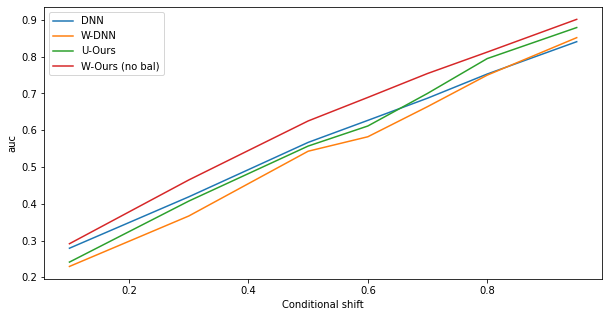

<Figure size 432x288 with 0 Axes>

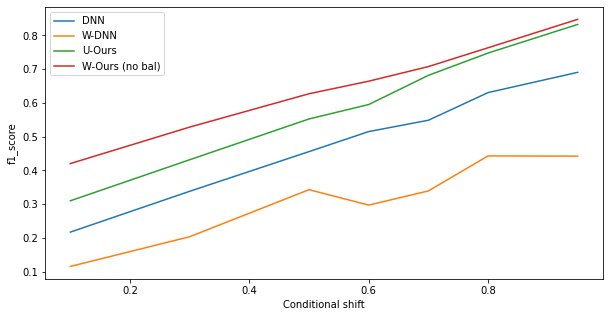

<Figure size 432x288 with 0 Axes>

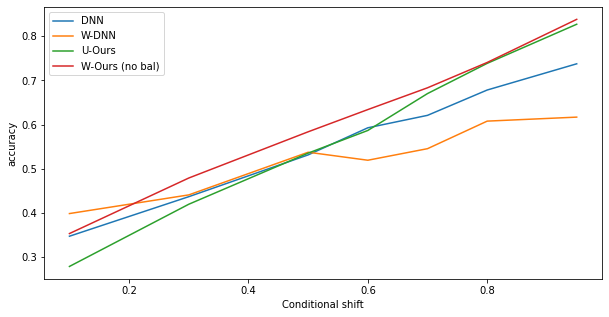

<Figure size 432x288 with 0 Axes>

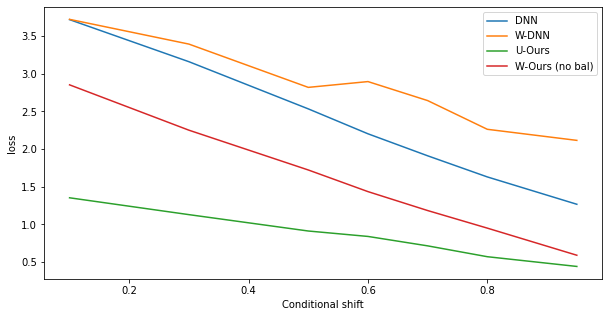

<Figure size 432x288 with 0 Axes>

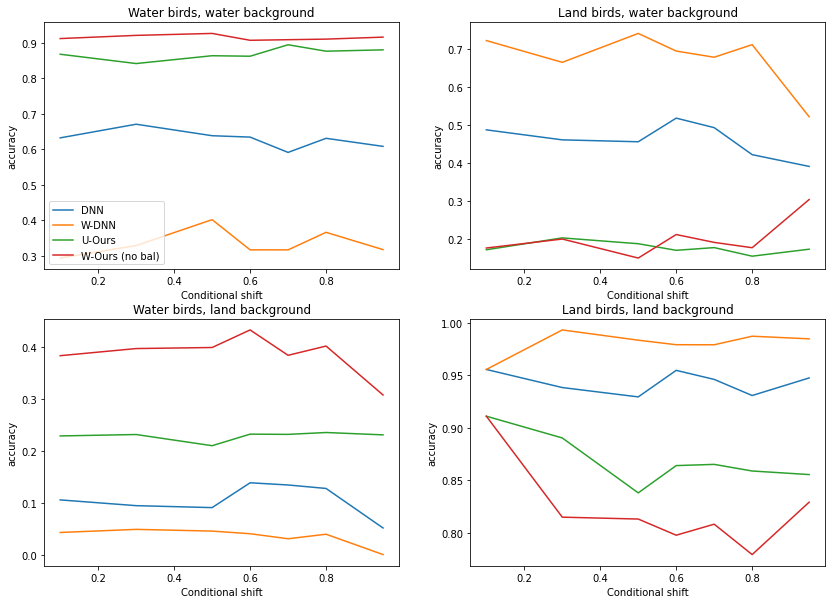

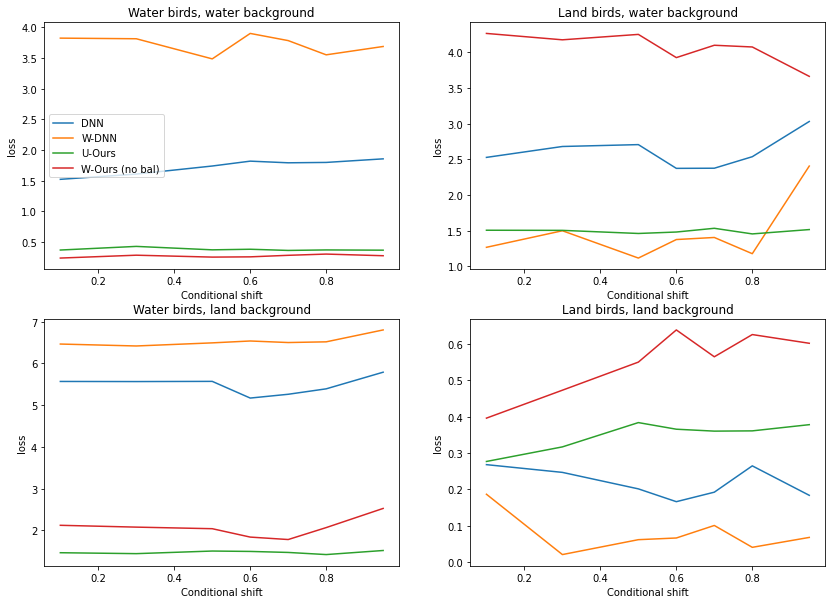

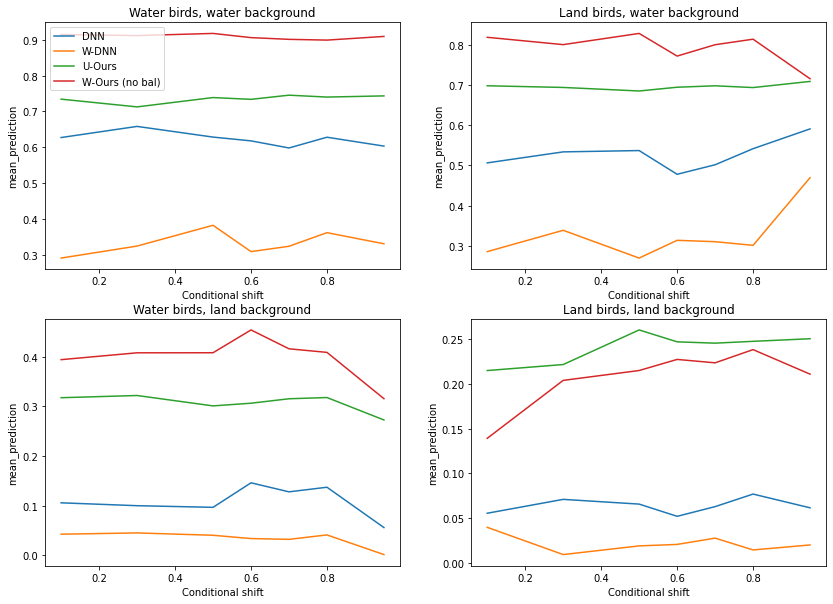

In [31]:
plot_metric_across_py(master_model_metric_dict, 'auc', False, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'f1_score', False, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'accuracy', False, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'loss', False, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'accuracy', True, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'loss', True, 0.0, 'biased_balanced_class')
plot_metric_across_py(master_model_metric_dict, 'mean_prediction', True, 0.0, 'biased_balanced_class')


In [29]:
for i in range(eval_x[0.5].shape[0]):
    plt.imshow(eval_x[0.5][i].numpy())
    plt.show()
    plt.clf()

<Figure size 432x288 with 0 Axes>

In [39]:
# --- get the predictions
model = get_model('slabs_x_v')
x = eval_x[0.5]
y = eval_y[0.5]
preds = model(tf.convert_to_tensor(x))['probabilities'].numpy()

In [60]:
mask = (y[:, 0] == 0) * (y[:, 1] == 1)
preds_mask = preds[mask]
x_mask = x[mask]

x0_mask = x_mask[(preds_mask < 0.2).ravel()]
x1_mask = x_mask[(preds_mask > 0.8).ravel()]




In [16]:
x = eval_x[0.5]
y = eval_y[0.5]

In [18]:
y11_mask = (y[:,0] * y[:,1]) ==1
y10_mask = (y[:,0] * 1 - y[:,1]) ==1
x11 = x[y11_mask]
x10 = x[y10_mask]


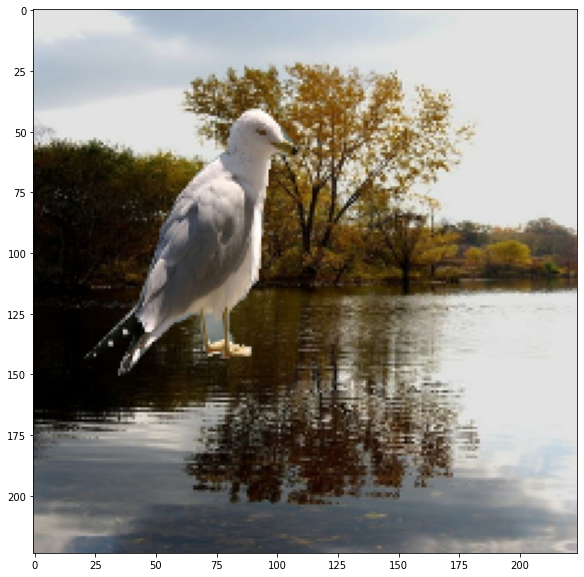

In [29]:
plt.figure(figsize=(10,10))
plt.imshow(x11[7,:,:])

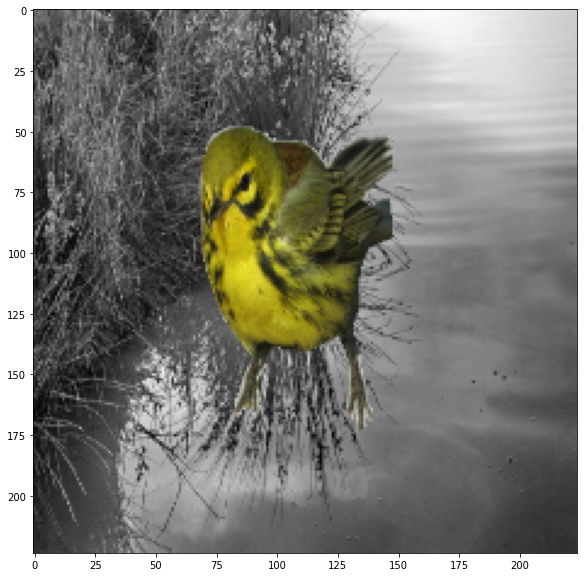

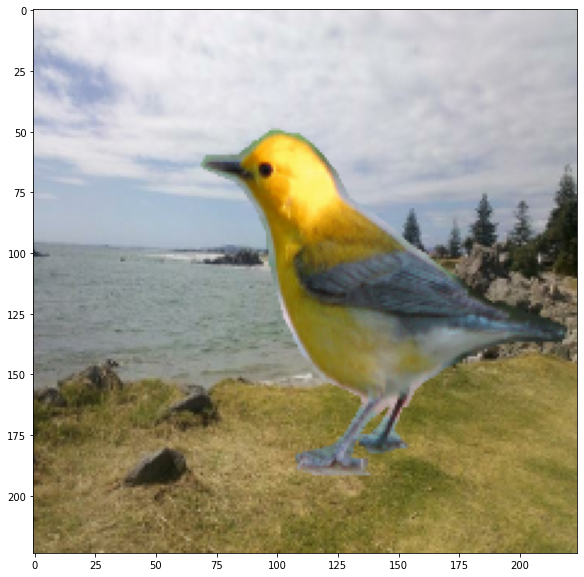

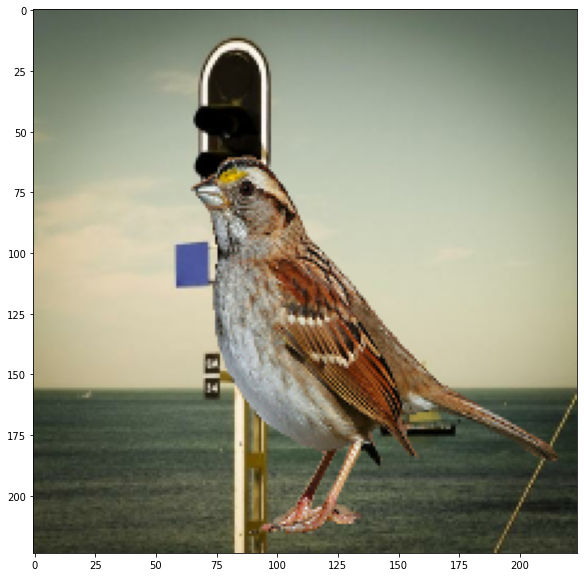

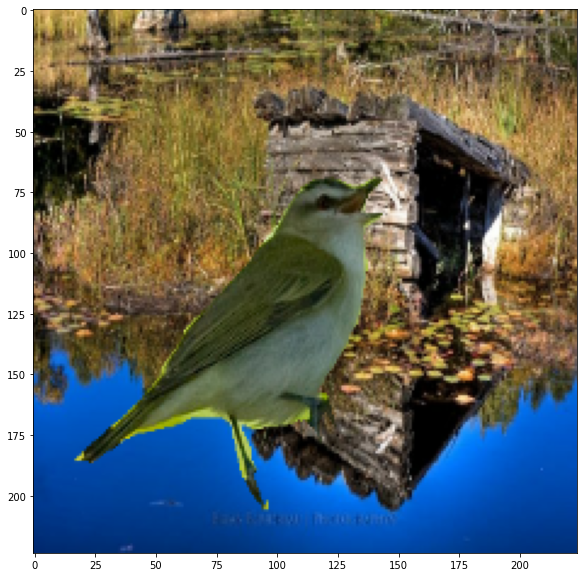

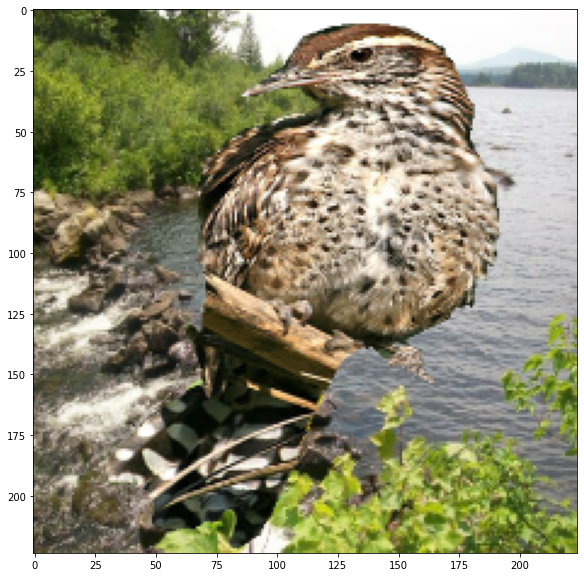

In [68]:
for i in range(min(x0_mask.shape[0], 5)):
    plt.figure(figsize=(10,10))
    plt.imshow(x0_mask[i])

<ipython-input-66-27f14e870d81>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,10))


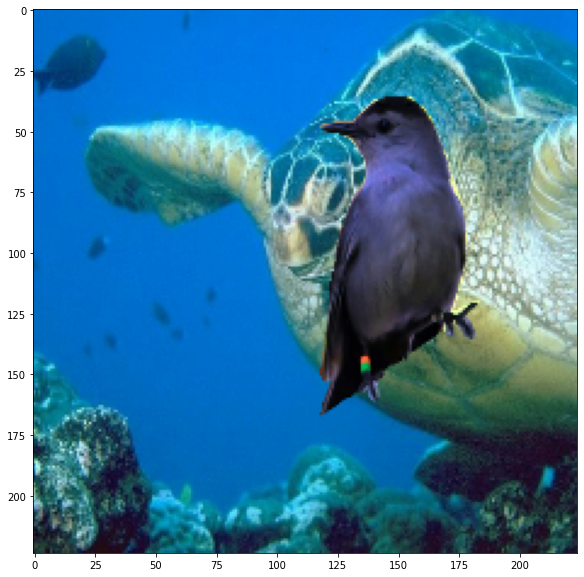

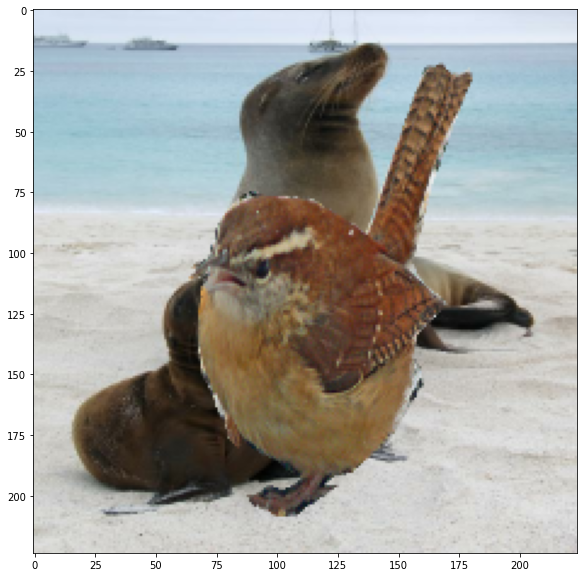

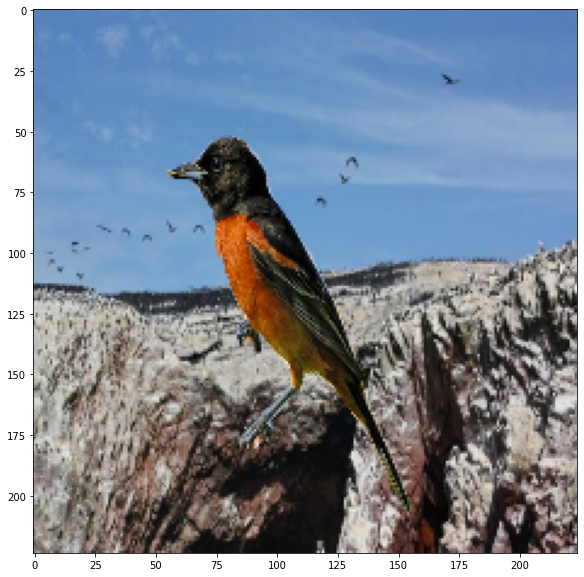

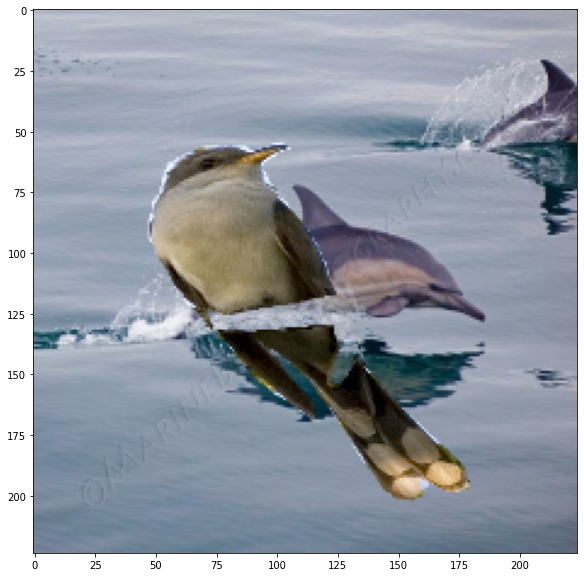

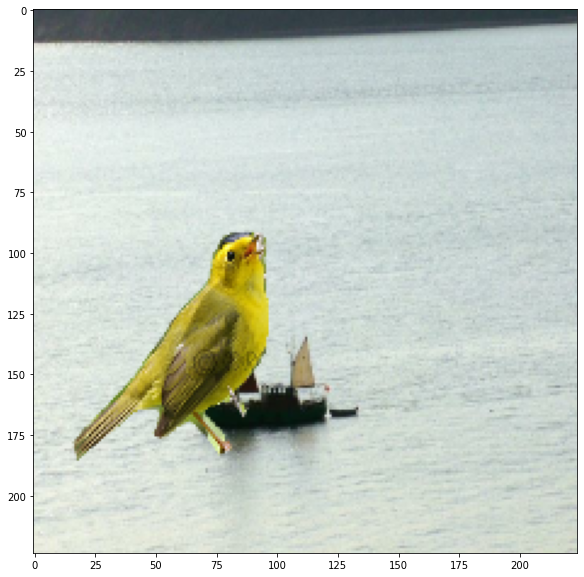

...

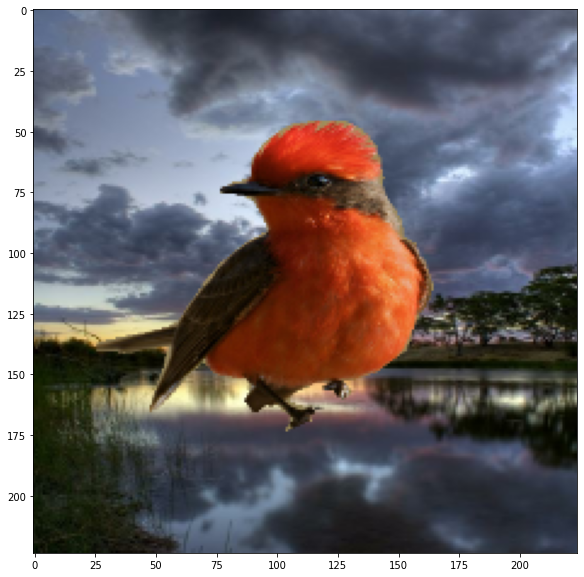

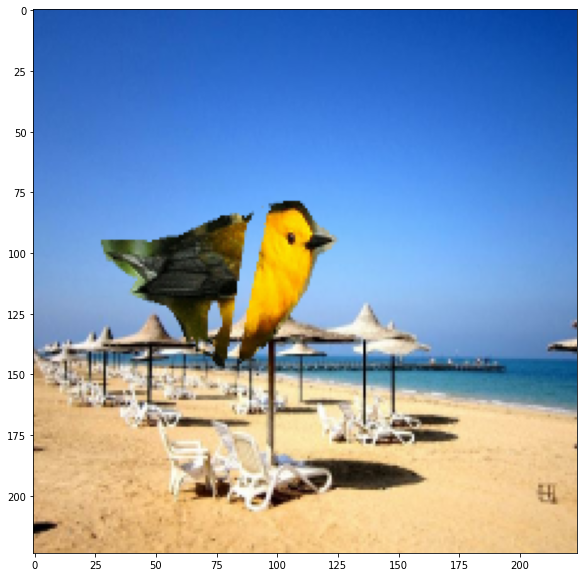

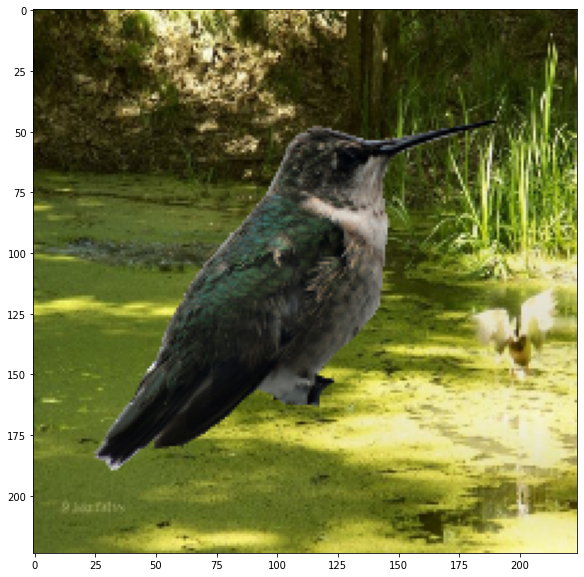

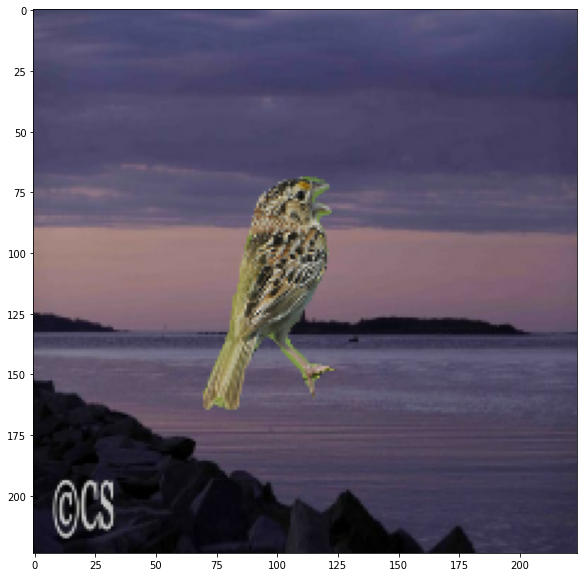

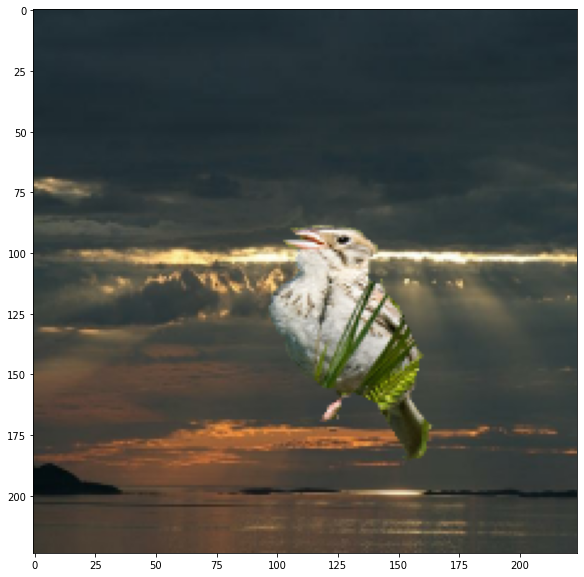

In [66]:
for i in range(min(x1_mask.shape[0], 5)):
    plt.figure(figsize=(10,10))
    plt.imshow(x1_mask[i])

In [23]:
model = get_model('slabs_x_v')
x = eval_x[0.5]
y = eval_y[0.5]
preds = model(tf.convert_to_tensor(x))['embedding'].numpy()
preds.shape

(33, 2048)

In [42]:
# model = get_model('simple_baseline')
x = eval_x[0.95]
y = eval_y[0.95]


In [43]:
import shared.weighting as wt
import pandas as pd


In [44]:
weights, weights_pos, weights_neg = \
    wt.get_weights_balanced(y[:,0], y[:,1])

In [45]:
df = pd.DataFrame(data=y)
df.columns = ['bird', 'back']
df['wpos'] = weights_pos
df['wneg'] = weights_neg

In [46]:
pd.crosstab(df.bird, df.back)

back,0.0,1.0
bird,,
0.0,1720,119
1.0,33,486


In [33]:
print(np.sum(df.wpos[((df.bird==1) & (df.back ==1))]) / np.sum(df.back))
print(np.sum(df.wpos[((df.bird==0) & (df.back ==1))]) / np.sum(df.back))

print(np.sum(df.wneg[((df.bird==1) & (df.back ==0))]) / np.sum(1. - df.back))
print(np.sum(df.wneg[((df.bird==0) & (df.back ==0))]) / np.sum(1. - df.back))


0.13178031
0.118453875
0.1288644
0.12121081


In [47]:
print(df[((df.bird==1) & (df.back ==1))].shape[0] / np.sum(df.back))
print(df[((df.bird==0) & (df.back ==1))].shape[0] / np.sum(df.back))

print(df[((df.bird==1) & (df.back ==0))].shape[0] / np.sum(1. - df.back))
print(df[((df.bird==0) & (df.back ==0))].shape[0] / np.sum(1. - df.back))


0.8033057851239669
0.19669421487603306
0.018824871648602397
0.9811751283513976


In [50]:
df['y0'] = df['bird']
df['y1'] = df['back']
water_back_water_bird_weight = np.sum(df.y0 * df.y1) / np.sum(df.y1)
water_back_land_bird_weight = np.sum( (1.0 - df.y0) * df.y1) / np.sum(df.y1)

land_back_water_bird_weight = np.sum(df.y0 * (1.0 - df.y1)) / np.sum((1.0 - df.y1))
land_back_land_bird_weight = np.sum( (1.0 - df.y0) * (1.0 - df.y1)) / np.sum((1.0 - df.y1))

print(water_back_water_bird_weight)
print(water_back_land_bird_weight)

print(land_back_water_bird_weight)
print(land_back_land_bird_weight)


0.8033058
0.19669421
0.018824872
0.9811751


In [48]:
print(df[((df.bird==1) & (df.back ==1))].shape[0] / np.sum(df.bird))
print(df[((df.bird==1) & (df.back ==0))].shape[0] / np.sum(df.bird))

print(df[((df.bird==0) & (df.back ==1))].shape[0] / np.sum(1 - df.bird))
print(df[((df.bird==0) & (df.back ==0))].shape[0] / np.sum(1 - df.bird))



0.9364161849710982
0.06358381502890173
0.06470908102229472
0.9352909189777052


In [53]:
df['wpos2'] = df.back * df.bird * df[((df.bird==1) & \
                (df.back==1))].shape[0] / df[(df.back==1)].shape[0] + \
            df.back * (1 - df.bird) * df[((df.bird==0) & \
                (df.back==1))].shape[0] / df[(df.back==1)].shape[0] 

df['wneg2'] = (1 - df.back) * df.bird * df[((df.bird==1) & \
                (df.back==0))].shape[0] / df[(df.back==0)].shape[0] + \
            (1 - df.back)* (1 - df.bird) * df[((df.bird==0) & \
                (df.back==0))].shape[0] / df[(df.back==0)].shape[0] 


In [54]:
df.wpos2.value_counts()

0.000000    1753
0.803306     486
0.196694     119
Name: wpos2, dtype: int64

In [55]:
df.wneg2.value_counts()

0.981175    1720
0.000000     605
0.018825      33
Name: wneg2, dtype: int64

In [56]:
df['test'] = 1 / df.wpos2

In [62]:
df.test.isin([np.nan, np.inf, -np.inf]).sum()

1753

In [63]:
water_back_water_bird_weight = np.sum(df.y0 * df.y1) / np.sum(df.y1)
water_back_land_bird_weight = np.sum( (1.0 - df.y0) * df.y1
    ) / np.sum(df.y1)

land_back_water_bird_weight = np.sum(df.y0 * (1.0 - df.y1)
    ) / np.sum((1.0 - df.y1))
land_back_land_bird_weight = np.sum( (1.0 - df.y0) * (1.0 - df.y1)
    ) / np.sum((1.0 - df.y1))

# -- positive weights 
df['weights_pos'] = df.y0 * water_back_water_bird_weight + \
                (1.0 - df.y0) * water_back_land_bird_weight
df['weights_pos'] = 1.0 / df['weights_pos']
df['weights_pos'] = df.y1 * df['weights_pos']

assert df.weights_pos.isin([np.nan, np.inf, -np.inf]).sum() == 0

df['balanced_weights_pos'] = np.mean(df.y0) * df.y0 * df.weights_pos + \
    np.mean(1.0 - df.y0) * (1.0 - df.y0) * df.weights_pos


# -- negative weights
df['weights_neg'] =	df.y0 *  land_back_water_bird_weight + \
                (1.0 - df.y0) * land_back_land_bird_weight
df['weights_neg'] = 1.0 / df['weights_neg']
df['weights_neg'] = (1.0 - df.y1) * df['weights_neg']

assert df.weights_neg.isin([np.nan, np.inf, -np.inf]).sum() == 0

df['balanced_weights_neg'] = np.mean(df.y0) * df.y0 * df.weights_neg + \
    np.mean(1.0 - df.y0) * (1.0 - df.y0) * df.weights_neg


# aggregate weights 
df['weights'] = df['weights_pos'] + df['weights_neg']
df['balanced_weights'] = df['balanced_weights_pos'] + df['balanced_weights_neg']

In [73]:
df.balanced_weights_pos.value_counts()

0.000000    1753
0.273995     486
3.965029     119
Name: balanced_weights_pos, dtype: int64

In [74]:
df.balanced_weights_neg.value_counts()

0.794861     1720
0.000000      605
11.692073      33
Name: balanced_weights_neg, dtype: int64

In [75]:
df.balanced_weights.value_counts()

0.794861     1720
0.273995      486
3.965029      119
11.692073      33
Name: balanced_weights, dtype: int64

In [83]:
eval_x, eval_y = get_eval_data(eval_input_fn_creater, [0.1])

-----0.1: 0/16----


In [84]:
eval_y

{0.1: array([[1., 0.],
        [1., 0.],
        [1., 0.],
        ...,
        [0., 1.],
        [1., 0.],
        [1., 0.]], dtype=float32)}

In [9]:
curr_data = train_input_fn({'pixel': PIXEL, 'batch_size': BATCH_SIZE})
for batch_id, examples in enumerate(curr_data):
    x, y = examples
    print(x.shape)
    for y_key, y_val in y.items():
        print(y_key)
        print(y_val.shape)
        print(y_val[:, 0].shape)
    assert 1==2 

(64, 224, 224, 3)
labels
(64, 2)
(64,)
unbalanced_weights
(64, 3)
(64,)
balanced_weights
(64, 3)
(64,)


AssertionError: 

In [ ]:
 eval_fn = eval_input_fn_creater(py, {'pixel': PIXEL, 'batch_size': BATCH_SIZE})
        current_eval_data = eval_fn()